In [35]:
from google.colab import drive
from google.colab import files

drive.mount("/content/drive") # Mount Google Drive

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

demo = pd.read_csv('/content/drive/MyDrive/sml/demographics.csv')
diet = pd.read_csv('/content/drive/MyDrive/sml/dietary.csv')
exam = pd.read_csv('/content/drive/MyDrive/sml/examination.csv')
lab = pd.read_csv('/content/drive/MyDrive/sml/laboratory.csv')
quest = pd.read_csv('/content/drive/MyDrive/sml/questionnaire.csv')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [36]:
# Columns for Different Datasets

# Demographic Information Columns
demo_cols = [
    'SEQN',      # 'participant_id'
    'RIAGENDR',  # 'gender' (categorical)
    'RIDAGEYR',  # 'age'
    'RIDRETH1',  # 'race' (categorical)
    'DMDFMSIZ',  # 'Total number of people in the Family'
    'INDFMIN2'   # 'annual family income'
]

# Diet-Related Columns
diet_cols = [
    'DRQSDIET',  # On special diet? 1 - yes; 2 - no, 9 - do not know
    'DRQSDT1',   # Weight loss/Low calorie diet 1 - yes, . - missing
    'DRQSDT2',   # Low fat/Low cholesterol diet 2 - yes, . - missing
    'DRQSDT3',   # Low salt/Low sodium diet 3 - yes, . - missing
    'DRQSDT4',   # Sugar free/Low sugar diet 4 - yes, . - missing
    # 'DRQSDT7',   # Diabetic diet 7 - yes, . - missing
    'DRQSDT8',   # Weight gain/Muscle building diet 9 - yes, . - missing
    'DRQSDT9',   # Low carbohydrate diet 9 - yes, . - missing
    'DRQSDT10',  # High protein diet 10 - yes, . - missing
    'DRQSDT11',  # Gluten-free/Celiac diet 11 - yes, . - missing
    'DR1TKCAL',  # energy (kcal)
    'DR1TPROT',  # protein (gm)
    'DR1TCARB',  # carbohydrate (gm)
    'DR1TSUGR',  # total sugars (gm)
    'DR1TTFAT',  # total fat (gm)
    'DR1TCHOL',  # cholesterol (mg)
    'DR1TALCO',  # alcohol (gm)
    'DR1TCAFF',  # caffeine (gm)
    'DR1TMOIS',  # Moisture (gm)
    'DR1_320Z',  # Total plain water drank yesterday (gm)
    'DR1_330Z',  # Total tap water drank yesterday (gm)
    'DR1BWATZ',  # Total bottled water drank yesterday (gm)
    'DRD340',    # Shellfish eaten during past 30 days 1 - yes, 2 - no, 7 - refused, 9 - do not know
    'DRD360',    # Fish eaten during past 30 days 1 - yes, 2 - no, 7 - refused, 9 - do not know
    'SEQN'       # 'participant_id' (repeated column)
]

# Examination Data Columns
exam_cols = [
    'SEQN',   # Participant ID
    'BPXPLS', # Blood pressure (pulse)
    'BMXWT',  # Weight (kg)
    'BMXHT',  # Height (cm)
    'BMXBMI', # BMI (kg/m²)
    'BMXWAIST' # Waist Circumference (cm)
]

# Questionnaire Data Columns
quest_cols = [
    'SEQN',   # Participant ID
    'ALQ130', # Average # alcohol drinks/day - past 12 months
    'ALQ151', # Ever have 4/5 or more drinks every day? (Yes = 1, No = 2, Refused = 7, Don't know = 9)
    'CBD071', # Money spent at supermarket/grocery store
    'CBD111', # Money spent on food at other stores
    'CBD121', # Money spent on eating out
    'CBD131', # Money spent on carryout/delivered foods
    'DIQ010', # Doctor told you have diabetes? (1 = Yes, 2 = No, 3 = Borderline, 7 = Refused, 9 = Don't know)
    'DBD895', # Number of meals not home prepared
    'DBD905', # Number of ready-to-eat foods in past 30 days
    'DBD910', # Number of frozen meals/pizza in past 30 days
    'PAQ610', # Number of days vigorous work
    'PAQ625', # Number of days moderate work
    'PAQ640', # Number of days walk or bicycle
    'PAQ655', # Days vigorous recreational activities
    'PAQ670'  # Days moderate recreational activities
]


In [37]:
# Merging all the features
merged_df = demo[demo_cols] \
    .merge(diet[diet_cols], on='SEQN', how='left') \
    .merge(exam[exam_cols], on='SEQN', how='left') \
    .merge(quest[quest_cols], on='SEQN', how='left')

In [38]:
# print(merged_df.head())
print(merged_df.shape)

(9254, 49)


In [39]:
# Dropping "refused" and "do not know" answers, removing participants of certain age
merged_df.dropna(subset=['DIQ010'], inplace=True)
merged_df.replace([np.inf, -np.inf], np.nan, inplace=True)
merged_df = merged_df[(merged_df['RIDAGEYR']>=16) & (merged_df['RIDAGEYR']<=85)]
merged_df.drop(merged_df[(merged_df['INDFMIN2'] == 77) | \
                           (merged_df['INDFMIN2'] == 99)].index, inplace = True)
merged_df['BPXPLS'] = merged_df['BPXPLS'].apply(lambda x: 1 if x == 1 else 0)
merged_df['RIAGENDR'] = merged_df['RIAGENDR'].apply(lambda x: 1 if x == 1 else 0)
merged_df['Race_Hispanic'] = merged_df['RIDRETH1'].map(lambda x: 1 if x in [1, 2] else 0)
merged_df['Race_White'] = merged_df['RIDRETH1'].map(lambda x: 1 if x == 3 else 0)
merged_df['Race_Black'] = merged_df['RIDRETH1'].map(lambda x: 1 if x == 4 else 0)
merged_df['Multi_Racial'] = merged_df['RIDRETH1'].map(lambda x: 1 if x == 5 else 0)
merged_df.drop(columns=['RIDRETH1'], inplace=True)

In [40]:
# Remove "Refused" and "Do not know" answers

# print(merged_df.dtypes)

# Replace '.' with 0 in diet-related columns
columns_to_replace_with_0 = [
    'DRQSDIET','DR1_320Z', 'DR1_330Z', 'DRD340', 'DRD360'
]

columns = ['DRQSDT1', 'DRQSDT2', 'DRQSDT3', 'DRQSDT4', 'DRQSDT8', 'DRQSDT9',
           'DRQSDT10', 'DRQSDT11','BPXPLS']
merged_df[columns_to_replace_with_0] = merged_df[columns_to_replace_with_0].fillna(0)
merged_df['DRQSDIET'] = merged_df['DRQSDIET'].apply(lambda x: 1 if x == 1 else 0)  # 1 = Yes, 0 = No
merged_df['DRD340'] = merged_df['DRD340'].apply(lambda x: 1 if x == 1 else 0)  # 1 = Yes, 0 = No
merged_df['DRD360'] = merged_df['DRD360'].apply(lambda x: 1 if x == 1 else 0)  # 1 = Yes, 0 = No
merged_df = merged_df.drop(columns=columns)
merged_df.drop(merged_df[(merged_df['ALQ130'] == 777) | (merged_df['ALQ130'] == 999)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['ALQ151'] == 7) | (merged_df['ALQ151'] == 9)].index, inplace=True)
merged_df['ALQ151'] = merged_df['ALQ151'].apply(lambda x: 1 if x == 1 else 0)  # 1 = Yes, 0 = No
merged_df.drop(merged_df[(merged_df['CBD071'] == 777777) | (merged_df['CBD071'] == 999999) | (merged_df['CBD071'] == 8400)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['CBD111'] == 777777) | (merged_df['CBD111'] == 999999) | (merged_df['CBD111'] == 8400)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['CBD121'] == 777777) | (merged_df['CBD121'] == 999999)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['CBD131'] == 777777) | (merged_df['CBD131'] == 999999)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['DIQ010'] == 7) | (merged_df['DIQ010'] == 9)].index, inplace=True)
merged_df['DIQ010'] = merged_df['DIQ010'].apply(lambda x: 1 if x == 1 else 0)  # 1 = Yes, 0 = No
merged_df.drop(merged_df[(merged_df['DBD905'] == 6666) | (merged_df['DBD905'] == 7777) | (merged_df['DBD905'] == 9999)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['DBD910'] == 6666) | (merged_df['DBD910'] == 7777) | (merged_df['DBD910'] == 9999)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['PAQ610'] == 77) | (merged_df['PAQ610'] == 99)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['PAQ625'] == 77) | (merged_df['PAQ625'] == 99)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['PAQ640'] == 77) | (merged_df['PAQ640'] == 99)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['PAQ655'] == 77) | (merged_df['PAQ655'] == 99)].index, inplace=True)
merged_df.drop(merged_df[(merged_df['PAQ670'] == 77) | (merged_df['PAQ670'] == 99)].index, inplace=True)
print(merged_df.dtypes)


SEQN             float64
RIAGENDR           int64
RIDAGEYR         float64
DMDFMSIZ         float64
INDFMIN2         float64
DRQSDIET           int64
DR1TKCAL         float64
DR1TPROT         float64
DR1TCARB         float64
DR1TSUGR         float64
DR1TTFAT         float64
DR1TCHOL         float64
DR1TALCO         float64
DR1TCAFF         float64
DR1TMOIS         float64
DR1_320Z         float64
DR1_330Z         float64
DR1BWATZ         float64
DRD340             int64
DRD360             int64
BMXWT            float64
BMXHT            float64
BMXBMI           float64
BMXWAIST         float64
ALQ130           float64
ALQ151             int64
CBD071           float64
CBD111           float64
CBD121           float64
CBD131           float64
DIQ010             int64
DBD895           float64
DBD905           float64
DBD910           float64
PAQ610           float64
PAQ625           float64
PAQ640           float64
PAQ655           float64
PAQ670           float64
Race_Hispanic      int64


In [41]:
# Find categorical and continuous variables
categorical = [
    'DRQSDIET',
    'RIAGENDR',
    'DIQ010',
    'Race_Hispanic',
    'Race_White',
    'Race_Black',
    'Multi_Racial',
    'ALQ151',
    'SEQN',
    'DRD340',
    'DRD360'
]

all_cols = list(merged_df)

continuous = [col for col in all_cols if col not in categorical]
continuous.sort()
print(continuous)
categorical = [
    'DRQSDIET',
    'RIAGENDR',
    'DIQ010',
    'Race_Hispanic',
    'Race_White',
    'Race_Black',
    'Multi_Racial',
    'ALQ151',
    'SEQN',
    'DRD340',
    'DRD360'
]

['ALQ130', 'BMXBMI', 'BMXHT', 'BMXWAIST', 'BMXWT', 'CBD071', 'CBD111', 'CBD121', 'CBD131', 'DBD895', 'DBD905', 'DBD910', 'DMDFMSIZ', 'DR1BWATZ', 'DR1TALCO', 'DR1TCAFF', 'DR1TCARB', 'DR1TCHOL', 'DR1TKCAL', 'DR1TMOIS', 'DR1TPROT', 'DR1TSUGR', 'DR1TTFAT', 'DR1_320Z', 'DR1_330Z', 'INDFMIN2', 'PAQ610', 'PAQ625', 'PAQ640', 'PAQ655', 'PAQ670', 'RIDAGEYR']


In [42]:
print(merged_df.isnull().sum())


SEQN                0
RIAGENDR            0
RIDAGEYR            0
DMDFMSIZ            0
INDFMIN2          338
DRQSDIET            0
DR1TKCAL          768
DR1TPROT          768
DR1TCARB          768
DR1TSUGR          768
DR1TTFAT          768
DR1TCHOL          768
DR1TALCO          768
DR1TCAFF          768
DR1TMOIS          768
DR1_320Z            0
DR1_330Z            0
DR1BWATZ          768
DRD340              0
DRD360              0
BMXWT             382
BMXHT             380
BMXBMI            389
BMXWAIST          597
ALQ130           2401
ALQ151              0
CBD071            338
CBD111            338
CBD121            338
CBD131            341
DIQ010              0
DBD895              0
DBD905              1
DBD910              2
PAQ610           4371
PAQ625           3382
PAQ640           4361
PAQ655           4314
PAQ670           3510
Race_Hispanic       0
Race_White          0
Race_Black          0
Multi_Racial        0
dtype: int64


In [43]:
merged_df.fillna(merged_df.mean(), inplace=True)
print(merged_df.isnull().sum())
merged_df.dropna(inplace=True)
# print(merged_df.isnull().sum())

SEQN             0
RIAGENDR         0
RIDAGEYR         0
DMDFMSIZ         0
INDFMIN2         0
DRQSDIET         0
DR1TKCAL         0
DR1TPROT         0
DR1TCARB         0
DR1TSUGR         0
DR1TTFAT         0
DR1TCHOL         0
DR1TALCO         0
DR1TCAFF         0
DR1TMOIS         0
DR1_320Z         0
DR1_330Z         0
DR1BWATZ         0
DRD340           0
DRD360           0
BMXWT            0
BMXHT            0
BMXBMI           0
BMXWAIST         0
ALQ130           0
ALQ151           0
CBD071           0
CBD111           0
CBD121           0
CBD131           0
DIQ010           0
DBD895           0
DBD905           0
DBD910           0
PAQ610           0
PAQ625           0
PAQ640           0
PAQ655           0
PAQ670           0
Race_Hispanic    0
Race_White       0
Race_Black       0
Multi_Racial     0
dtype: int64


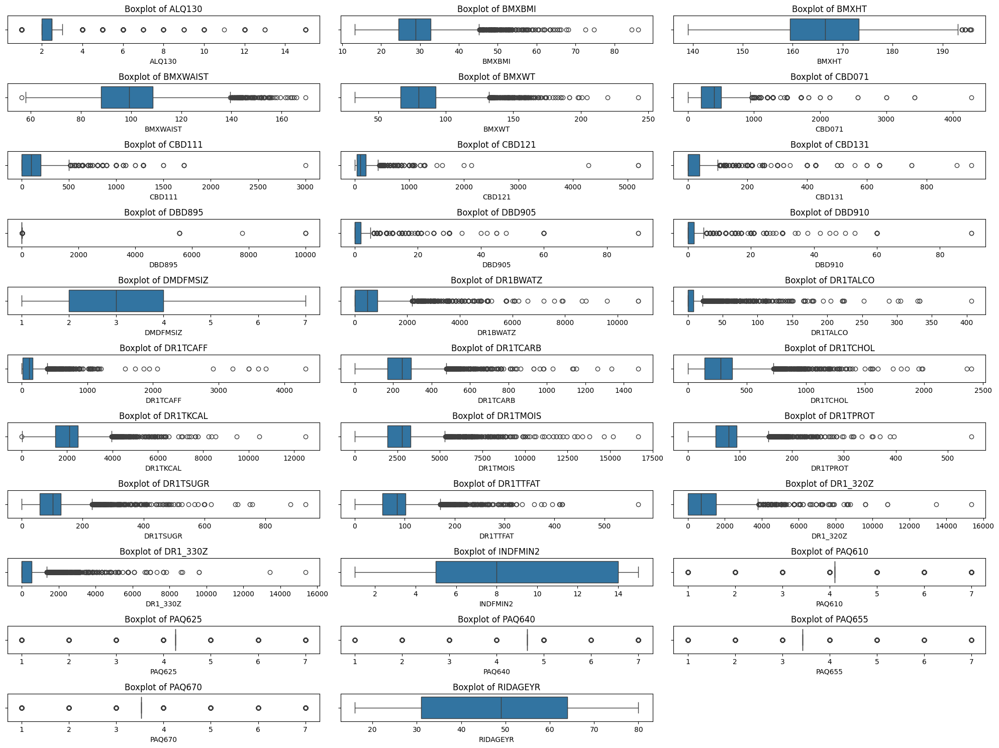

In [44]:
# Plot histograms for continuous
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 15))
num_cols = len(continuous)
num_rows = (num_cols + 2) // 3

for i, col in enumerate(continuous, 1):
    plt.subplot(num_rows, 3, i)
    sns.boxplot(x=merged_df[col].dropna())
    plt.title(f'Boxplot of {col}')
plt.tight_layout()
plt.show()

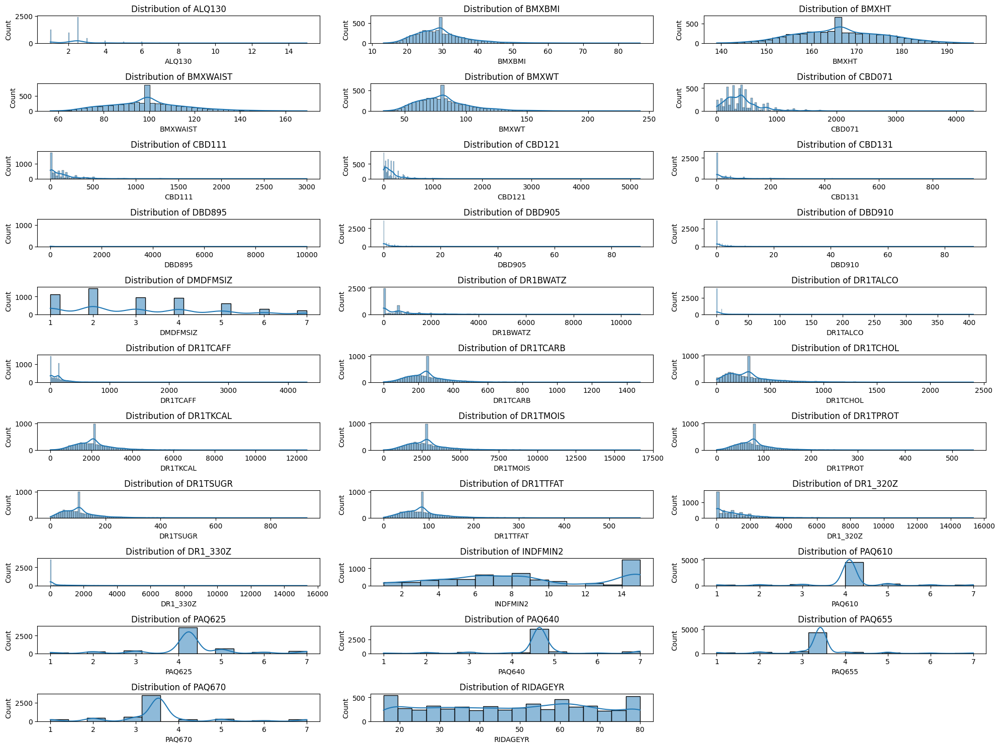

In [45]:
# Plot histograms
plt.figure(figsize=(20, 15))
num_cols = len(continuous)
num_rows = (num_cols + 2) // 3

for i, col in enumerate(continuous, 1):
    plt.subplot(num_rows, 3, i)
    sns.histplot(merged_df[col].dropna(), kde=True)
    plt.title(f'Distribution of {col}')

plt.tight_layout()
plt.show()

In [46]:
sns.pairplot(merged_df, vars=continuous, hue='DIQ010', diag_kind='kde')
print("Continuous vs. Continuous: ")
plt.show()

Continuous vs. Continuous: 


<ipython-input-47-9b6ec4a3a373>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=merged_df[col], palette='viridis')
<ipython-input-47-9b6ec4a3a373>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=merged_df[col], palette='viridis')
<ipython-input-47-9b6ec4a3a373>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x=merged_df[col], palette='viridis')
<ipython-input-47-9b6ec4a3a373>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legen

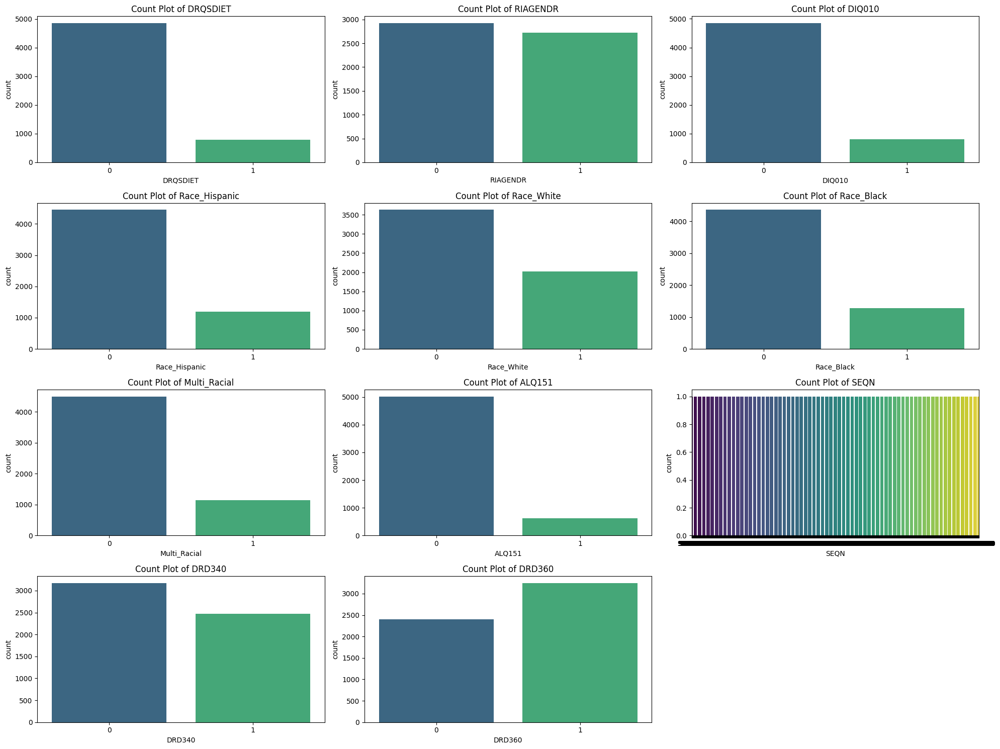

In [47]:
# Plot count plots
plt.figure(figsize=(20, 15))
num_cols = 3  # Number of columns
num_rows = int(np.ceil(len(categorical) / num_cols))

for i, col in enumerate(categorical, 1):
    plt.subplot(num_rows, num_cols, i)
    sns.countplot(x=merged_df[col], palette='viridis')
    plt.title(f'Count Plot of {col}')
plt.tight_layout()
plt.show()

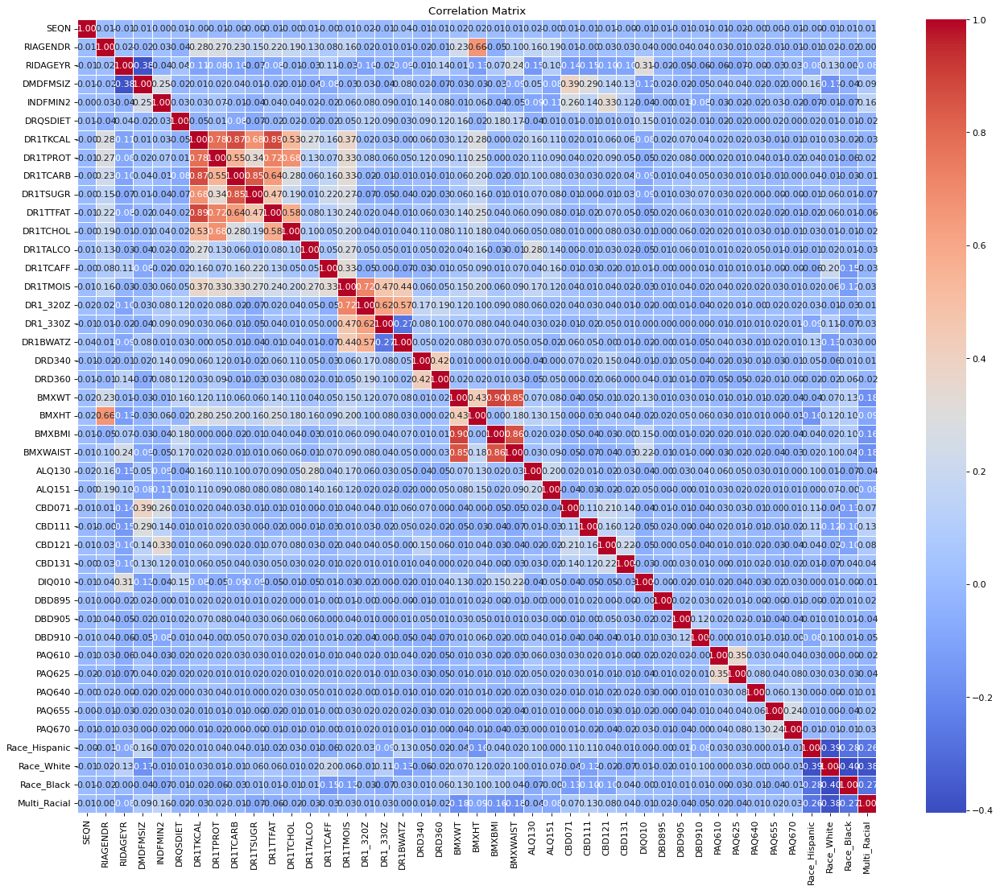

In [48]:
# Correlation matrix
corr_matrix = merged_df.corr()

# heatmap
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 16), dpi=80)
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [49]:
merged_df.drop(['DR1TMOIS'], axis=1, inplace=True)
merged_df.drop(['BMXBMI'], axis=1, inplace=True)
merged_df.drop(['BMXWAIST'], axis=1, inplace=True)
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# combine
macro_columns = ['DR1TCARB', 'DR1TTFAT', 'DR1TPROT', 'DR1TKCAL']

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(merged_df[macro_columns])

# Apply PCA
pca = PCA(n_components=1)
pca_components = pca.fit_transform(scaled_data)

merged_df['PCA_Macro'] = pca_components

merged_df.drop(columns=macro_columns, inplace=True)

print("Explained variance ratio for PCA component:", pca.explained_variance_ratio_)
print("PCA Components (linear combination of macros):")
print(pca.components_)
print(merged_df.head())

Explained variance ratio for PCA component: [0.80981546]
PCA Components (linear combination of macros):
[[0.4727927  0.50461367 0.46975915 0.54877905]]
      SEQN  RIAGENDR  RIDAGEYR  DMDFMSIZ   INDFMIN2  DRQSDIET    DR1TSUGR  \
2  93705.0         0      66.0       1.0   3.000000         0   91.550000   
3  93706.0         1      18.0       5.0   8.613906         0   14.730000   
5  93708.0         0      66.0       2.0   6.000000         0   49.840000   
6  93709.0         0      75.0       1.0   2.000000         0  106.291745   
8  93711.0         1      56.0       3.0  15.000000         1  148.210000   

     DR1TCHOL  DR1TALCO    DR1TCAFF  ...    PAQ610    PAQ625   PAQ640  \
2   14.000000  0.000000  361.000000  ...  4.105181  4.247017  4.64486   
3  462.000000  0.000000    0.000000  ...  4.105181  4.247017  5.00000   
5   71.000000  0.000000   33.000000  ...  4.105181  4.247017  4.64486   
6  301.669059  8.444228  137.014558  ...  4.105181  2.000000  4.64486   
8  546.000000  0.000

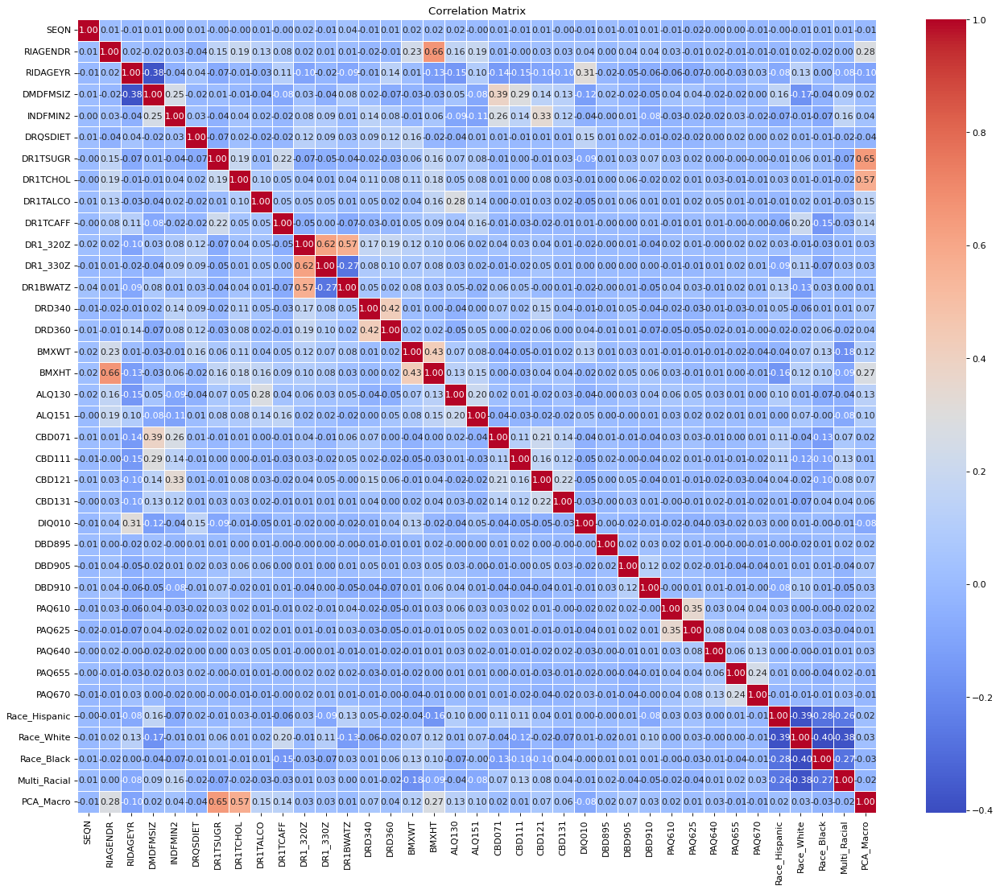

In [50]:
# Correlation matrix
corr_matrix = merged_df.corr()

# heatmap
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 16), dpi=80)  # Increased figure size (width, height)
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [51]:
print(merged_df.shape)

(5645, 37)


In [52]:
# Pregnant and people who take diabetic pills to lower blood sugar are dropped
quest_filtered = quest[quest[['DIQ070', 'RHD143']].eq(1).all(axis=1)][['SEQN']]
seqn_to_drop = quest_filtered['SEQN'].tolist()  # Convert SEQN values to a list
merged_df = merged_df[~merged_df['SEQN'].isin(seqn_to_drop)] # drop values if present
print(merged_df.shape)

(5643, 37)


In [53]:
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder,OneHotEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, accuracy_score, recall_score, confusion_matrix
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline


y = merged_df['DIQ010'].copy()
X = merged_df.drop(columns=['SEQN', 'DIQ010'])


y = y.dropna()  # Remove rows with NaN values
X = X.loc[y.index]

print(X.shape)
print(y.shape)

continuous_vars = X.select_dtypes(include=['float64']).columns
categorical_vars = X.select_dtypes(include=['int64']).columns
one_hot_encoder = OneHotEncoder(drop='first')

# Scaling continuous features
scaler = StandardScaler()
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', one_hot_encoder, categorical_vars),
        ('num', scaler, continuous_vars)
    ])


(5643, 35)
(5643,)


In [54]:
# print(X)
# print(y)

In [55]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train_scaled = preprocessor.fit_transform(X_train)
X_test_scaled = preprocessor.transform(X_test)

smote = SMOTE(random_state=42)
X_train_scaled, y_train = smote.fit_resample(X_train_scaled, y_train)

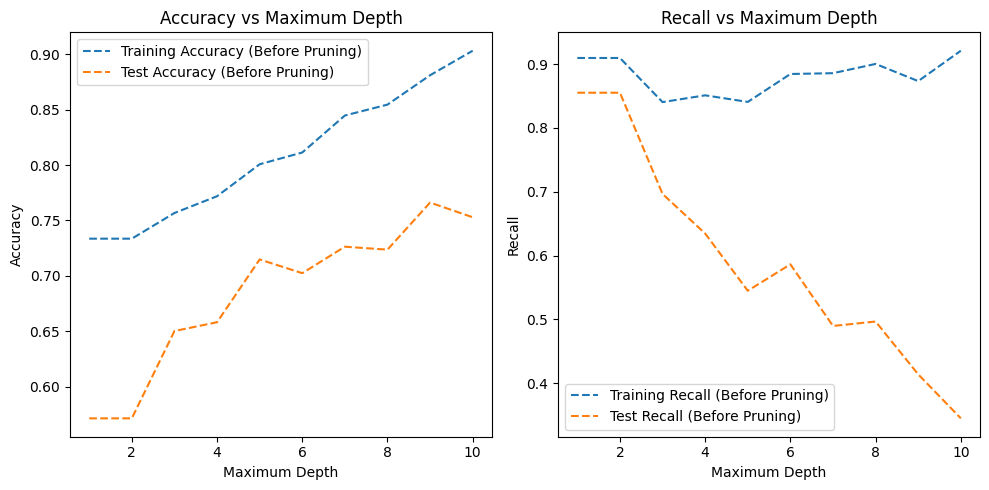

In [56]:
# Decision Tree Model
max_depths = range(1, 11)  # Depths from 1 to 10
train_accuracies = []
test_accuracies = []
train_recalls = []
test_recalls = []


for depth in max_depths:
    dt_model = DecisionTreeClassifier(max_depth=depth, random_state=42)
    dt_model.fit(X_train_scaled, y_train)

    train_accuracies.append(accuracy_score(y_train, dt_model.predict(X_train_scaled)))
    test_accuracies.append(accuracy_score(y_test, dt_model.predict(X_test_scaled)))
    train_recalls.append(recall_score(y_train, dt_model.predict(X_train_scaled)))
    test_recalls.append(recall_score(y_test, dt_model.predict(X_test_scaled)))

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.plot(max_depths, train_accuracies, '--', label='Training Accuracy (Before Pruning)')
plt.plot(max_depths, test_accuracies, '--', label='Test Accuracy (Before Pruning)')
plt.xlabel('Maximum Depth')
plt.ylabel('Accuracy')
plt.title('Accuracy vs Maximum Depth')
plt.legend()


plt.subplot(1, 2, 2)
plt.plot(max_depths, train_recalls, '--', label='Training Recall (Before Pruning)')
plt.plot(max_depths, test_recalls, '--', label='Test Recall (Before Pruning)')
plt.xlabel('Maximum Depth')
plt.ylabel('Recall')
plt.title('Recall vs Maximum Depth')
plt.legend()

plt.tight_layout()
plt.show()

Cross-validation scores (Recall) for Decision Tree: [0.70504528 0.90944373 0.88082902 0.90803109 0.88212435]
Mean CV Recall: 0.8570946919679064

Confusion Matrix for Training Data:
[[2938  924]
 [ 615 3247]]

Confusion Matrix for Test Data:
[[728 256]
 [ 66  79]]


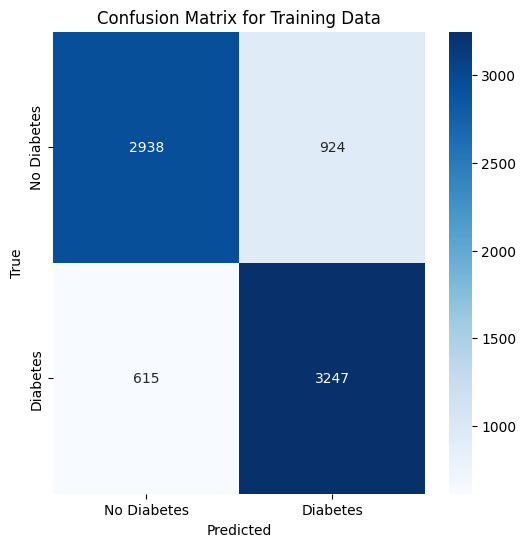

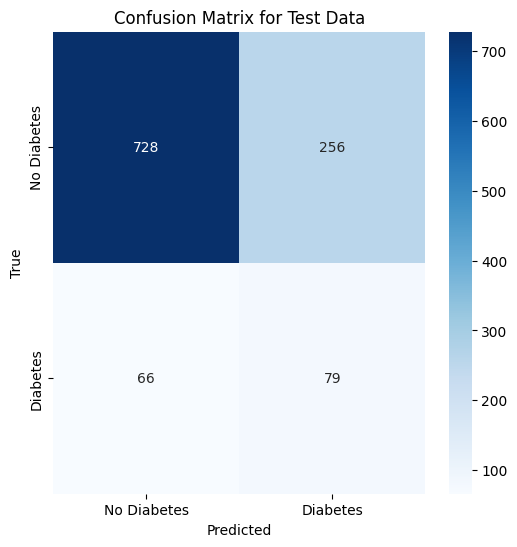


Classification Report for Training Data:
              precision    recall  f1-score   support

           0       0.83      0.76      0.79      3862
           1       0.78      0.84      0.81      3862

    accuracy                           0.80      7724
   macro avg       0.80      0.80      0.80      7724
weighted avg       0.80      0.80      0.80      7724


Classification Report for Test Data:
              precision    recall  f1-score   support

           0       0.92      0.74      0.82       984
           1       0.24      0.54      0.33       145

    accuracy                           0.71      1129
   macro avg       0.58      0.64      0.57      1129
weighted avg       0.83      0.71      0.76      1129



In [57]:
#Decision Tree model
dt = DecisionTreeClassifier(max_depth = 5, random_state=42)
#Cross-validation on the training data
cv_scores = cross_val_score(dt, X_train_scaled, y_train, cv=5, scoring='recall')  # Using recall as scoring
print(f"Cross-validation scores (Recall) for Decision Tree: {cv_scores}")
print(f"Mean CV Recall: {cv_scores.mean()}")

dt.fit(X_train_scaled, y_train)


y_train_pred = dt.predict(X_train_scaled)
y_test_pred = dt.predict(X_test_scaled)


print("\nConfusion Matrix for Training Data:")
cm_train = confusion_matrix(y_train, y_train_pred)
print(cm_train)


print("\nConfusion Matrix for Test Data:")
cm_test = confusion_matrix(y_test, y_test_pred)
print(cm_test)

plt.figure(figsize=(6, 6))
sns.heatmap(cm_train, annot=True, fmt='d', cmap='Blues', xticklabels=['No Diabetes', 'Diabetes'], yticklabels=['No Diabetes', 'Diabetes'])
plt.title('Confusion Matrix for Training Data')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

#Confusion matrix for test data
plt.figure(figsize=(6, 6))
sns.heatmap(cm_test, annot=True, fmt='d', cmap='Blues', xticklabels=['No Diabetes', 'Diabetes'], yticklabels=['No Diabetes', 'Diabetes'])
plt.title('Confusion Matrix for Test Data')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Classification report for training data
print("\nClassification Report for Training Data:")
print(classification_report(y_train, y_train_pred))

# Classification report for test data
print("\nClassification Report for Test Data:")
print(classification_report(y_test, y_test_pred))

In [58]:
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import GridSearchCV

pruned_train_accuracies = []
pruned_test_accuracies = []
pruned_train_recalls = []
pruned_test_recalls = []

parameter = {
    'criterion' : ['entropy', 'gini', 'log_loss'],
    'splitter'  : ['best', 'random'],
    'max_features' : ['sqrt', 'log2', None]  # Fixed max_features parameter
}

model = DecisionTreeClassifier()

# GridSearchCV for model optimization for Decision Tree Model
cv = GridSearchCV(model, param_grid=parameter, cv=5, scoring='recall')  # Prioritize recall during grid search
cv.fit(X_train_scaled, y_train)

# Best model from GridSearchCV
best_model = cv.best_estimator_

# Cost-complexity pruning
path = best_model.cost_complexity_pruning_path(X_train_scaled, y_train)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

# Different alpha values
pruned_models = []
for ccp_alpha in ccp_alphas:
    pruned_model = DecisionTreeClassifier(criterion="gini", ccp_alpha=ccp_alpha)
    pruned_model.fit(X_train_scaled, y_train)
    pruned_models.append(pruned_model)

# Best pruned model based on recall
best_recall = 0
best_pruned_model = None
for pruned_model in pruned_models:
    recall = recall_score(y_test, pruned_model.predict(X_test_scaled))
    if recall > best_recall:
        best_recall = recall
        best_pruned_model = pruned_model

# Model performance after pruning
recall_after_pruning = best_recall
print(f"Recall after pruning: {recall_after_pruning:.4f}")
print("\nClassification Report for the Best Model (Highest Recall) Training:")
print(classification_report(y_train, best_pruned_model.predict(X_train_scaled)))
print("\nClassification Report for the Best Model (Highest Recall) Testing:")
print(classification_report(y_test, best_pruned_model.predict(X_test_scaled)))

Recall after pruning: 0.8552

Classification Report for the Best Model (Highest Recall) Training:
              precision    recall  f1-score   support

           0       0.86      0.56      0.68      3862
           1       0.67      0.91      0.77      3862

    accuracy                           0.73      7724
   macro avg       0.77      0.73      0.73      7724
weighted avg       0.77      0.73      0.73      7724


Classification Report for the Best Model (Highest Recall) Testing:
              precision    recall  f1-score   support

           0       0.96      0.53      0.68       984
           1       0.21      0.86      0.34       145

    accuracy                           0.57      1129
   macro avg       0.59      0.69      0.51      1129
weighted avg       0.86      0.57      0.64      1129



[0.         0.05386179 0.47052846 1.        ]


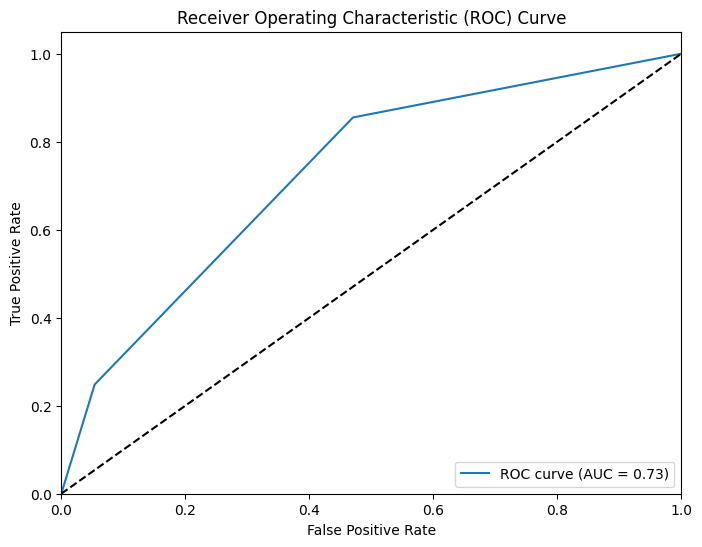

In [59]:
y_pred_prob = best_pruned_model.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)
print(fpr)
# ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

Mean f1: 0.837
Mean recall: 0.897
Mean precision: 0.784


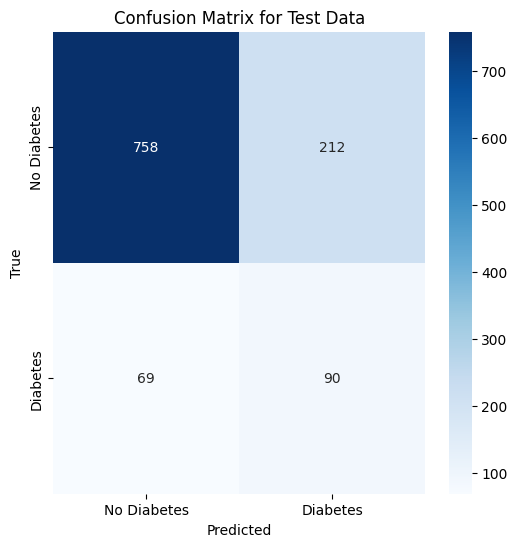


Classification Report for Test Data:
              precision    recall  f1-score   support

           0       0.92      0.78      0.84       970
           1       0.30      0.57      0.39       159

    accuracy                           0.75      1129
   macro avg       0.61      0.67      0.62      1129
weighted avg       0.83      0.75      0.78      1129


Classification Report for Train Data:
              precision    recall  f1-score   support

           0       0.90      0.79      0.84      3876
           1       0.81      0.91      0.86      3876

    accuracy                           0.85      7752
   macro avg       0.86      0.85      0.85      7752
weighted avg       0.86      0.85      0.85      7752



In [60]:
from statistics import mean
from sklearn.model_selection import train_test_split, cross_validate, RepeatedStratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report
from imblearn.ensemble import BalancedRandomForestClassifier

# Random Forest model
# SRF = BalancedRandomForestClassifier(n_estimators=150, random_state=0)

SRF = RandomForestClassifier(max_depth=5, n_estimators=150, random_state=0)

smote = SMOTE()
X_1 = preprocessor.fit_transform(X)
X_over, y_over = smote.fit_resample(X_1, y)
X_train, X_test, y_train, y_test = train_test_split(X_1, y, test_size=0.2, stratify=y, random_state=42)
# Preprocessor to both training and testing data:
# X_train = preprocessor.fit_transform(X_train)
# X_test = preprocessor.transform(X_test)
X_train, y_train = smote.fit_resample(X_train, y_train)
# X_train_over, X_test_over, y_train_over, y_test_over = train_test_split(X_over, y_over, test_size=0.2, stratify=y_over, random_state=42)
# Stratified K-Fold Cross Validation with 10 splits and 3 repeats
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=1)


scoring = ('f1', 'recall', 'precision')

# Cross-validation
scores = cross_validate(SRF, X_over, y_over, scoring=scoring, cv=cv)

print('Mean f1: %.3f' % mean(scores['test_f1']))
print('Mean recall: %.3f' % mean(scores['test_recall']))
print('Mean precision: %.3f' % mean(scores['test_precision']))

#  Random Forest model on the training data
SRF.fit(X_train, y_train)

# Predict on the test set
y_pred = SRF.predict(X_test)
# Confusion matrix for the test set
cm_test = confusion_matrix(y_test, y_pred)

# Confusion matrix for test data
plt.figure(figsize=(6, 6))
sns.heatmap(cm_test, annot=True, fmt='d', cmap='Blues', xticklabels=['No Diabetes', 'Diabetes'], yticklabels=['No Diabetes', 'Diabetes'])
plt.title('Confusion Matrix for Test Data')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Classification report
print("\nClassification Report for Test Data:")
print(classification_report(y_test, y_pred))
print("\nClassification Report for Train Data:")
print(classification_report(y_train, SRF.predict(X_train)))

In [61]:
SRF = RandomForestClassifier(n_estimators=150, random_state=0)
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=1)

scoring = ('f1', 'recall', 'precision')

#Cross-validation
scores_nor = cross_validate(SRF, X_1, y, scoring=scoring, cv=cv)

# Average evaluation metrics from cross-validation
print('Mean f1: %.3f' % mean(scores_nor['test_f1']))
print('Mean recall: %.3f' % mean(scores_nor['test_recall']))
print('Mean precision: %.3f' % mean(scores_nor['test_precision']))

Mean f1: 0.080
Mean recall: 0.043
Mean precision: 0.640


/usr/local/lib/python3.10/dist-packages/imblearn/ensemble/_forest.py:577: FutureWarning: The default of `sampling_strategy` will change from `'auto'` to `'all'` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `'all'` to silence this warning and adopt the future behaviour.
  warn(
/usr/local/lib/python3.10/dist-packages/imblearn/ensemble/_forest.py:589: FutureWarning: The default of `replacement` will change from `False` to `True` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `True` to silence this warning and adopt the future behaviour.
  warn(
/usr/local/lib/python3.10/dist-packages/imblearn/ensemble/_forest.py:601: FutureWarning: The default of `bootstrap` will change from `True` to `False` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `False` to silence this warning and adopt the future behaviour.
  warn(
/usr/local/lib/python3.

Mean f1: 0.420
Mean recall: 0.784
Mean precision: 0.287


/usr/local/lib/python3.10/dist-packages/imblearn/ensemble/_forest.py:577: FutureWarning: The default of `sampling_strategy` will change from `'auto'` to `'all'` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `'all'` to silence this warning and adopt the future behaviour.
  warn(
/usr/local/lib/python3.10/dist-packages/imblearn/ensemble/_forest.py:589: FutureWarning: The default of `replacement` will change from `False` to `True` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `True` to silence this warning and adopt the future behaviour.
  warn(
/usr/local/lib/python3.10/dist-packages/imblearn/ensemble/_forest.py:601: FutureWarning: The default of `bootstrap` will change from `True` to `False` in version 0.13. This change will follow the implementation proposed in the original paper. Set to `False` to silence this warning and adopt the future behaviour.
  warn(


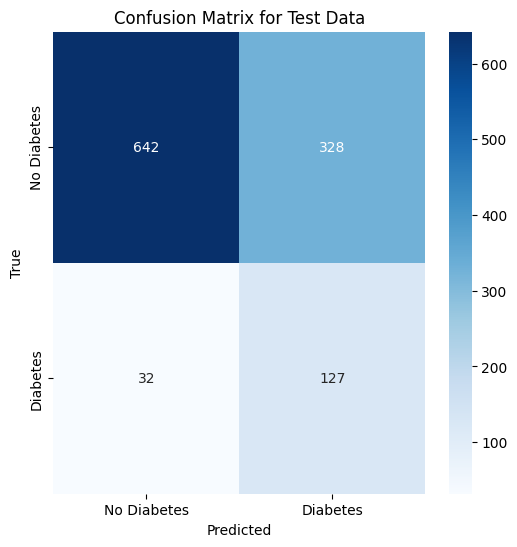


Classification Report for Test Data:
              precision    recall  f1-score   support

           0       0.95      0.66      0.78       970
           1       0.28      0.80      0.41       159

    accuracy                           0.68      1129
   macro avg       0.62      0.73      0.60      1129
weighted avg       0.86      0.68      0.73      1129


Classification Report for Train Data:
              precision    recall  f1-score   support

           0       1.00      0.77      0.87      3876
           1       0.41      1.00      0.58       638

    accuracy                           0.80      4514
   macro avg       0.71      0.88      0.73      4514
weighted avg       0.92      0.80      0.83      4514



In [62]:
# Random Forest model -> BALANCED
SRF = BalancedRandomForestClassifier(n_estimators=150, random_state=0)


scoring = ('f1', 'recall', 'precision')

# Cross-validation
scores = cross_validate(SRF, X, y, scoring=scoring, cv=cv)

# Evaluation metrics from cross-validation
print('Mean f1: %.3f' % mean(scores['test_f1']))
print('Mean recall: %.3f' % mean(scores['test_recall']))
print('Mean precision: %.3f' % mean(scores['test_precision']))

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)
X_train = preprocessor.fit_transform(X_train)
X_test = preprocessor.transform(X_test)

# Random Forest model on the training data
SRF.fit(X_train, y_train)

# Predict on the test set
y_pred = SRF.predict(X_test)

# Confusion matrix for the test set
cm_test = confusion_matrix(y_test, y_pred)

# Confusion matrix for test data
plt.figure(figsize=(6, 6))
sns.heatmap(cm_test, annot=True, fmt='d', cmap='Blues', xticklabels=['No Diabetes', 'Diabetes'], yticklabels=['No Diabetes', 'Diabetes'])
plt.title('Confusion Matrix for Test Data')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()

# Classification report
print("\nClassification Report for Test Data:")
print(classification_report(y_test, y_pred))
print("\nClassification Report for Train Data:")
print(classification_report(y_train, SRF.predict(X_train)))

In [63]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train_scaled = preprocessor.fit_transform(X_train)
X_test_scaled = preprocessor.transform(X_test)

smote = SMOTE(random_state=42)
X_train_scaled, y_train = smote.fit_resample(X_train_scaled, y_train)

In [64]:
import xgboost as xgb
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression

# Logistic Regression Model
print("\nLogistic Regression:")
log_reg = LogisticRegression(max_iter=2000, random_state=42)
log_reg.fit(X_train_scaled, y_train)

# Make predictions
y_pred = log_reg.predict(X_test_scaled)

# Evaluate the model
recall = recall_score(y_test, y_pred)
print(f"Recall: {recall:.2f}")
print(classification_report(y_test, y_pred))
print(classification_report(y_train, log_reg.predict(X_train_scaled)))


Logistic Regression:
Recall: 0.77
              precision    recall  f1-score   support

           0       0.95      0.70      0.81       984
           1       0.27      0.77      0.40       145

    accuracy                           0.71      1129
   macro avg       0.61      0.74      0.61      1129
weighted avg       0.87      0.71      0.75      1129

              precision    recall  f1-score   support

           0       0.80      0.71      0.75      3862
           1       0.74      0.82      0.78      3862

    accuracy                           0.77      7724
   macro avg       0.77      0.77      0.77      7724
weighted avg       0.77      0.77      0.77      7724



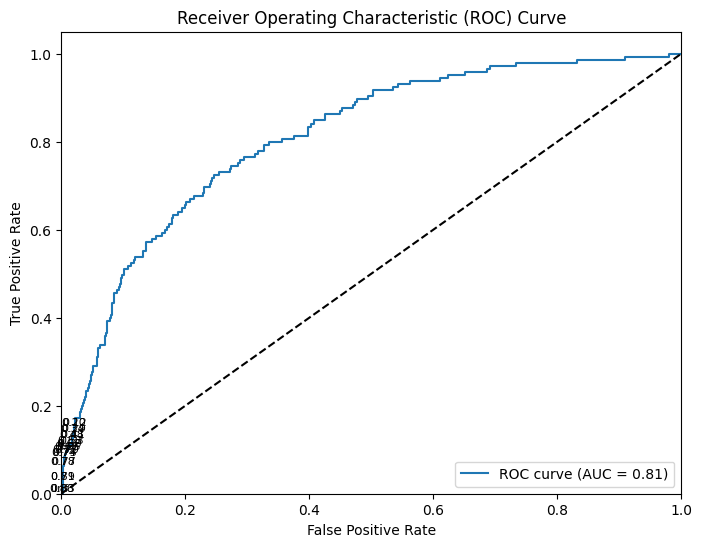

Best threshold for maximizing recall: 0.57
Classification Report for Testing Data (with Best Threshold):
              precision    recall  f1-score   support

           0       0.95      0.75      0.84       984
           1       0.30      0.72      0.43       145

    accuracy                           0.75      1129
   macro avg       0.63      0.74      0.63      1129
weighted avg       0.87      0.75      0.79      1129

Classification Report for Training Data (with Best Threshold):
              precision    recall  f1-score   support

           0       0.74      0.77      0.76      3862
           1       0.76      0.74      0.75      3862

    accuracy                           0.75      7724
   macro avg       0.75      0.75      0.75      7724
weighted avg       0.75      0.75      0.75      7724


Top 10 Features Based on Coefficients:
                 Feature  Coefficient
9          num__RIDAGEYR     1.213613
19            num__BMXWT     0.513053
1        cat__DRQSDIET_1

In [65]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import recall_score, classification_report, roc_curve, auc
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
import pandas as pd


#  GridSearchCV to tune hyperparameters, including regularization strength and class weights
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],
    'class_weight': ['balanced', None]
}

log_reg = LogisticRegression(max_iter=2000, random_state=42)
grid_search = GridSearchCV(log_reg, param_grid, scoring='recall', cv=5)
grid_search.fit(X_train_scaled, y_train)

# Get the best model
best_model = grid_search.best_estimator_

# Predictions with the best model
y_pred_prob = best_model.predict_proba(X_test_scaled)[:, 1]  # Probabilities for the positive class

#  ROC curve for all thresholds
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')  # Random classifier curve
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')

# Annotate thresholds
for i, threshold in enumerate(thresholds[::10]):
    plt.text(fpr[i], tpr[i], f'{threshold:.2f}', fontsize=8, ha='center', va='bottom')

plt.legend(loc="lower right")
plt.show()

# Best threshold
best_threshold = thresholds[np.argmax(tpr - fpr)]  # Maximizing recall
print(f"Best threshold for maximizing recall: {best_threshold:.2f}")

# Best threshold to make predictions
y_pred_adjusted = (y_pred_prob >= best_threshold).astype(int)

#  Classification Report for the best threshold
print("Classification Report for Testing Data (with Best Threshold):")
print(classification_report(y_test, y_pred_adjusted))

print("Classification Report for Training Data (with Best Threshold):")
y_train_pred_prob = best_model.predict_proba(X_train_scaled)[:, 1]
y_train_pred_adjusted = (y_train_pred_prob >= best_threshold).astype(int)
print(classification_report(y_train, y_train_pred_adjusted))


# Top 10 Features Based on Model Coefficients
feature_names = preprocessor.get_feature_names_out()
coefficients = best_model.coef_[0]  # Coefficients from the logistic regression model
feature_importance = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})

feature_importance['Coefficient'] = feature_importance['Coefficient'].abs()
feature_importance = feature_importance.sort_values(by='Coefficient', ascending=False)

# T 10 most important features
print("\nTop 10 Features Based on Coefficients:")
print(feature_importance.head(10))


<ipython-input-66-9a05d248b761>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Coefficient', y='Feature', data=top_10_features, palette='viridis')


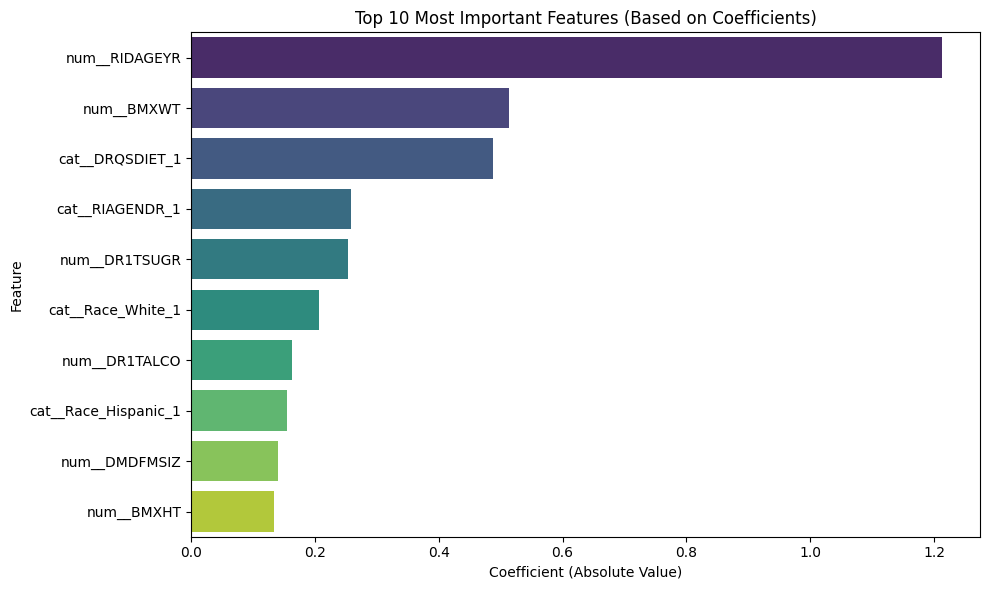

In [66]:
import matplotlib.pyplot as plt
import seaborn as sns

# Top 10 features
top_10_features = feature_importance.head(10)

# Horizontal bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x='Coefficient', y='Feature', data=top_10_features, palette='viridis')
plt.title('Top 10 Most Important Features (Based on Coefficients)')
plt.xlabel('Coefficient (Absolute Value)')
plt.ylabel('Feature')
plt.tight_layout()
plt.show()